In [2]:
import nest_asyncio
nest_asyncio.apply()

In [3]:
%run model.ipynb
%run data.ipynb

In [4]:
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

In [5]:
X_train, X_test, y_train, y_test = train_test_split(x, y,
                                                    random_state=1)
regr.fit(X_train, y_train)
#svr.fit(X_train, y_train)

Iteration 1, loss = 28.05774650
Iteration 2, loss = 20.17691663
Iteration 3, loss = 19.56479700
Iteration 4, loss = 19.26361362
Iteration 5, loss = 19.07183177
Iteration 6, loss = 18.88547481
Iteration 7, loss = 18.72053427
Iteration 8, loss = 18.54538578
Iteration 9, loss = 18.36938217
Iteration 10, loss = 18.27309732
Iteration 11, loss = 18.20923535
Iteration 12, loss = 18.12404658
Iteration 13, loss = 18.04788823
Iteration 14, loss = 17.99288482
Iteration 15, loss = 17.97215452
Iteration 16, loss = 17.91849036
Iteration 17, loss = 17.86493068
Iteration 18, loss = 17.84187892
Iteration 19, loss = 17.77217785
Iteration 20, loss = 17.77520329
Iteration 21, loss = 17.71573435
Iteration 22, loss = 17.66897769
Iteration 23, loss = 17.62900173
Iteration 24, loss = 17.56710573
Iteration 25, loss = 17.52679023
Iteration 26, loss = 17.49689924
Iteration 27, loss = 17.47150733
Iteration 28, loss = 17.41852930
Iteration 29, loss = 17.39027606
Iteration 30, loss = 17.36233743
Iteration 31, loss 

MLPRegressor(hidden_layer_sizes=(100, 30), learning_rate='adaptive',
             verbose=True)

Text(0, 0.5, 'loss value')

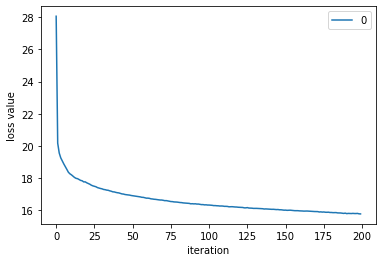

In [6]:
pd.DataFrame(regr.loss_curve_).plot()
plt.xlabel('iteration')
plt.ylabel('loss value')

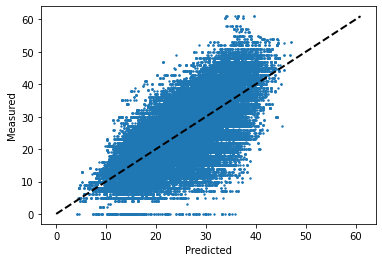

In [12]:
# predict = svr.predict(x)
# svr.score(x,y)
predict = regr.predict(X_test)
regr.score(X_test,y_test)
plt.scatter(predict,y_test,s=2)
#plt.plot(predict_y, predict_y, 'ro')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Predicted')
plt.ylabel('Measured')
plt.show()

In [13]:
# The mean squared error
from math import sqrt

print("Root mean squared error: %.2f"
      % sqrt(mean_squared_error(y_test, predict)))
# The absolute squared error
print("Mean absolute error: %.2f"
      % mean_absolute_error(y_test, predict))
# Explained variance score: 1 is perfect prediction
print('R-squared: %.2f' % r2_score(y_test, predict))

Root mean squared error: 5.64
Mean absolute error: 4.29
R-squared: 0.60


In [19]:
predict = regr.predict(test_without_ID)
val = pd.DataFrame({'預測乳量':predict})
x = test.join(val)
x_group = x.groupby(['ID']).mean()
x_index = list(range(0,x_group.shape[0]))
x_group.index

Int64Index([  480,   742,   743,   744,   745,   793,   794,   800,   801,
              802,
            ...
            37476, 37477, 37478, 37479, 37480, 37481, 37482, 37483, 37484,
            37485],
           dtype='int64', name='ID', length=4263)

Text(0, 0.5, 'predict value')

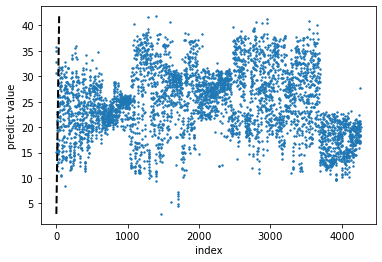

In [20]:
plt.scatter(x_index,x_group['預測乳量'].values,s=2)
#plt.plot(predict_y, predict_y, 'ro')
plt.plot([x_group['預測乳量'].values.min(), x_group['預測乳量'].values.max()], 
         [x_group['預測乳量'].values.min(),x_group['預測乳量'].values.max()], 'k--', lw=2)
plt.xlabel('index')
plt.ylabel('predict value')

In [25]:
for index in range(x_group.shape[0]):
    submission.loc[index, ['1']] = x_group['預測乳量'].values[index]
submission

,ID,預測乳量
0,480,15.130435
1,742,30.731492
2,743,35.673490
3,744,35.039769
4,745,32.760069
...,...,...
4258,37481,18.494443
4259,37482,18.326252
4260,37483,20.862591
4261,37484,27.724896


In [26]:
submission.columns = ['ID','預測乳量']
submission.to_csv('result.csv',index = False)